In [1]:
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt

<a id='1'></a>
### dataset.shuffle working

In [2]:
# Step 1: Create synthetic data
class_0 = [0] * 10  # 100 elements of class 0
class_1 = [1] * 10  # 100 elements of class 1
class_2 = [2] * 10  # 100 elements of class 1
data = class_0 + class_1 + class_2 # Concatenate the lists

# Convert the data into a TensorFlow dataset
dataset = tf.data.Dataset.from_tensor_slices(data)

# Step 2: Shuffle the dataset with buffer_size of 10
shuffled_dataset = dataset.shuffle(buffer_size=4) # seed=42 to fix randomization with buffer

# Step 3: Draw the first 20 elements from the shuffled dataset to see the mixing
for element in shuffled_dataset.take(30):
    print(element.numpy(), end=' ')

0 0 0 0 0 0 0 0 1 1 0 1 0 1 1 1 1 1 2 2 1 1 2 2 2 2 2 2 2 2 

## tfds.load

In [3]:
from IPython.core.magic import register_cell_magic

@register_cell_magic
def print_lines(line, cell):
    lines = cell.splitlines()
    for line in lines:
        if line[0]=='#':
           continue
        print(f'{line} = {eval(line)}')

In [4]:
dataset, info = tfds.load('oxford_iiit_pet:3.*.*', with_info=True, split='all')

In [5]:
dataset

<PrefetchDataset element_spec={'file_name': TensorSpec(shape=(), dtype=tf.string, name=None), 'image': TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), 'label': TensorSpec(shape=(), dtype=tf.int64, name=None), 'segmentation_mask': TensorSpec(shape=(None, None, 1), dtype=tf.uint8, name=None), 'species': TensorSpec(shape=(), dtype=tf.int64, name=None)}>

In [6]:
info

tfds.core.DatasetInfo(
    name='oxford_iiit_pet',
    full_name='oxford_iiit_pet/3.2.0',
    description="""
    The Oxford-IIIT pet dataset is a 37 category pet image dataset with roughly 200
    images for each class. The images have large variations in scale, pose and
    lighting. All images have an associated ground truth annotation of breed.
    """,
    homepage='http://www.robots.ox.ac.uk/~vgg/data/pets/',
    data_path='C:\\Users\\ramay\\tensorflow_datasets\\oxford_iiit_pet\\3.2.0',
    file_format=tfrecord,
    download_size=773.52 MiB,
    dataset_size=774.69 MiB,
    features=FeaturesDict({
        'file_name': Text(shape=(), dtype=string),
        'image': Image(shape=(None, None, 3), dtype=uint8),
        'label': ClassLabel(shape=(), dtype=int64, num_classes=37),
        'segmentation_mask': Image(shape=(None, None, 1), dtype=uint8),
        'species': ClassLabel(shape=(), dtype=int64, num_classes=2),
    }),
    supervised_keys=('image', 'label'),
    disable_shuffling

In [7]:
%%print_lines
info.name
info.full_name
# info.description
info.file_format
info.data_dir
info.dataset_size
info.disable_shuffling
info.supervised_keys
info.splits
info.homepage

info.name = oxford_iiit_pet
info.full_name = oxford_iiit_pet/3.2.0
info.file_format = FileFormat.TFRECORD
info.data_dir = C:\Users\ramay\tensorflow_datasets\oxford_iiit_pet\3.2.0
info.dataset_size = 774.69 MiB
info.disable_shuffling = False
info.supervised_keys = ('image', 'label')
info.splits = {'train': <SplitInfo num_examples=3680, num_shards=4>, 'test': <SplitInfo num_examples=3669, num_shards=4>}
info.homepage = http://www.robots.ox.ac.uk/~vgg/data/pets/


In [8]:
%%print_lines
info.splits.keys()
info.splits.items()
info.splits['train'].num_examples
info.splits['train'].filenames
info.splits['train'].filepaths
info.splits['train'].name

info.splits.keys() = dict_keys(['train', 'test'])
info.splits.items() = dict_items([('train', <SplitInfo num_examples=3680, num_shards=4>), ('test', <SplitInfo num_examples=3669, num_shards=4>)])
info.splits['train'].num_examples = 3680
info.splits['train'].filenames = ['oxford_iiit_pet-train.tfrecord-00000-of-00004', 'oxford_iiit_pet-train.tfrecord-00001-of-00004', 'oxford_iiit_pet-train.tfrecord-00002-of-00004', 'oxford_iiit_pet-train.tfrecord-00003-of-00004']
info.splits['train'].filepaths = [WindowsGPath('C:\\Users\\ramay\\tensorflow_datasets\\oxford_iiit_pet\\3.2.0\\oxford_iiit_pet-train.tfrecord-00000-of-00004'), WindowsGPath('C:\\Users\\ramay\\tensorflow_datasets\\oxford_iiit_pet\\3.2.0\\oxford_iiit_pet-train.tfrecord-00001-of-00004'), WindowsGPath('C:\\Users\\ramay\\tensorflow_datasets\\oxford_iiit_pet\\3.2.0\\oxford_iiit_pet-train.tfrecord-00002-of-00004'), WindowsGPath('C:\\Users\\ramay\\tensorflow_datasets\\oxford_iiit_pet\\3.2.0\\oxford_iiit_pet-train.tfrecord-00003-of-0000

In [9]:
%%print_lines
info.features
info.features['image']
info.features['label']
info.features['label'].shape
info.features['label'].tf_dtype
info.features['label'].num_classes
info.features['label'].names
info.features['label'].int2str(2)
info.features['label'].str2int('american_pit_bull_terrier')

info.features = FeaturesDict({
    'file_name': Text(shape=(), dtype=string),
    'image': Image(shape=(None, None, 3), dtype=uint8),
    'label': ClassLabel(shape=(), dtype=int64, num_classes=37),
    'segmentation_mask': Image(shape=(None, None, 1), dtype=uint8),
    'species': ClassLabel(shape=(), dtype=int64, num_classes=2),
})
info.features['image'] = Image(shape=(None, None, 3), dtype=uint8)
info.features['label'] = ClassLabel(shape=(), dtype=int64, num_classes=37)
info.features['label'].shape = ()
info.features['label'].tf_dtype = <dtype: 'int64'>
info.features['label'].num_classes = 37
info.features['label'].names = ['Abyssinian', 'american_bulldog', 'american_pit_bull_terrier', 'basset_hound', 'beagle', 'Bengal', 'Birman', 'Bombay', 'boxer', 'British_Shorthair', 'chihuahua', 'Egyptian_Mau', 'english_cocker_spaniel', 'english_setter', 'german_shorthaired', 'great_pyrenees', 'havanese', 'japanese_chin', 'keeshond', 'leonberger', 'Maine_Coon', 'miniature_pinscher', 'newfoundland'

In [10]:
%%print_lines
info.features['species']
info.features['species'].names
info.features['species'].int2str(1)
info.features['species'].str2int('Dog')
info.features['species'].num_classes

info.features['species'] = ClassLabel(shape=(), dtype=int64, num_classes=2)
info.features['species'].names = ['Cat', 'Dog']
info.features['species'].int2str(1) = Dog
info.features['species'].str2int('Dog') = 1
info.features['species'].num_classes = 2


In [11]:
%%print_lines
info.features['file_name']
info.features['file_name'].shape
info.features['file_name'].tf_dtype

info.features['file_name'] = Text(shape=(), dtype=string)
info.features['file_name'].shape = ()
info.features['file_name'].tf_dtype = <dtype: 'string'>


In [12]:
len(dataset)

7349

In [13]:
for d in dataset.take(3):
    print(d)
    print(d.keys())
    print(d['image'].shape)
    print(d['segmentation_mask'].shape)
    print(d['species'].numpy())

{'file_name': <tf.Tensor: shape=(), dtype=string, numpy=b'Sphynx_158.jpg'>, 'image': <tf.Tensor: shape=(500, 500, 3), dtype=uint8, numpy=
array([[[ 3,  3,  3],
        [ 5,  3,  4],
        [ 7,  5,  6],
        ...,
        [ 3,  1,  2],
        [ 3,  1,  2],
        [ 3,  1,  2]],

       [[ 4,  3,  1],
        [ 5,  3,  4],
        [ 5,  3,  4],
        ...,
        [ 6,  2,  3],
        [ 7,  3,  4],
        [ 8,  4,  5]],

       [[ 4,  3,  1],
        [ 5,  4,  2],
        [ 5,  3,  4],
        ...,
        [ 7,  3,  2],
        [ 8,  4,  3],
        [ 8,  4,  3]],

       ...,

       [[ 6, 10, 11],
        [ 6,  7,  9],
        [ 7,  8, 10],
        ...,
        [ 3,  4,  6],
        [ 3,  4,  6],
        [ 4,  5,  7]],

       [[ 8, 12, 13],
        [ 7,  8, 10],
        [ 8,  9, 11],
        ...,
        [ 4,  5,  9],
        [ 4,  5,  7],
        [ 4,  5,  7]],

       [[ 8, 12, 13],
        [ 7,  8, 10],
        [ 8,  9, 11],
        ...,
        [ 5,  6, 10],
        [ 5, 

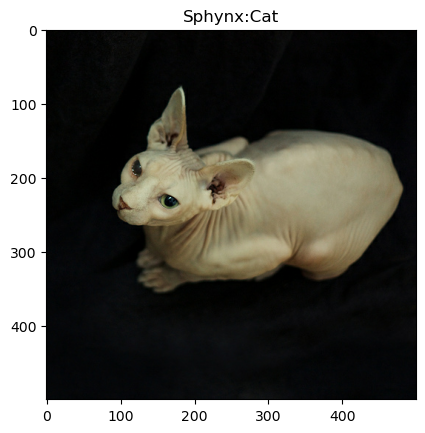

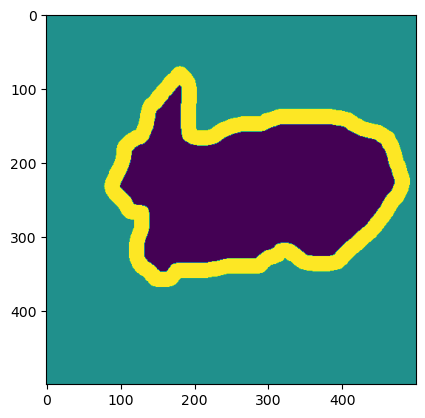

b'Sphynx_158.jpg'


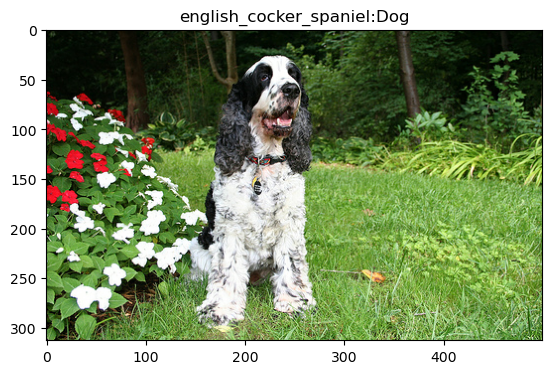

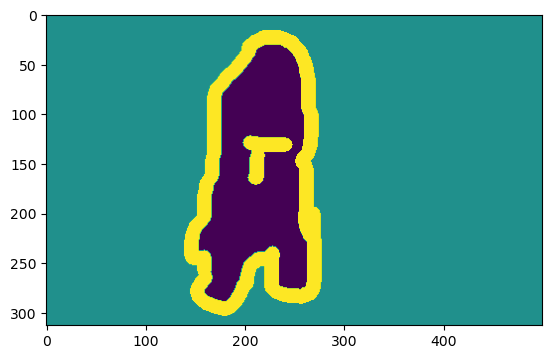

b'english_cocker_spaniel_135.jpg'


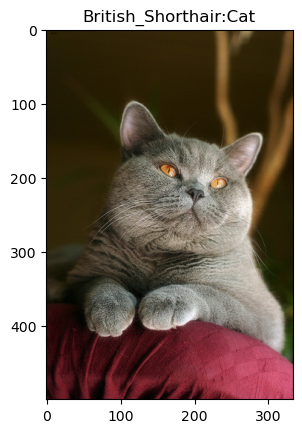

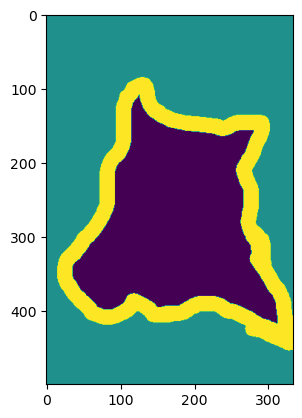

b'British_Shorthair_181.jpg'


In [14]:
for d in dataset.take(3):
    plt.figure()
    plt.imshow(d['image'])
    plt.title(info.features['label'].names[d['label'].numpy()]+':'+info.features['species'].names[d['species'].numpy()])
    plt.show()
    plt.figure()
    plt.imshow(d['segmentation_mask'])
    plt.show()
    print(d['file_name'].numpy())

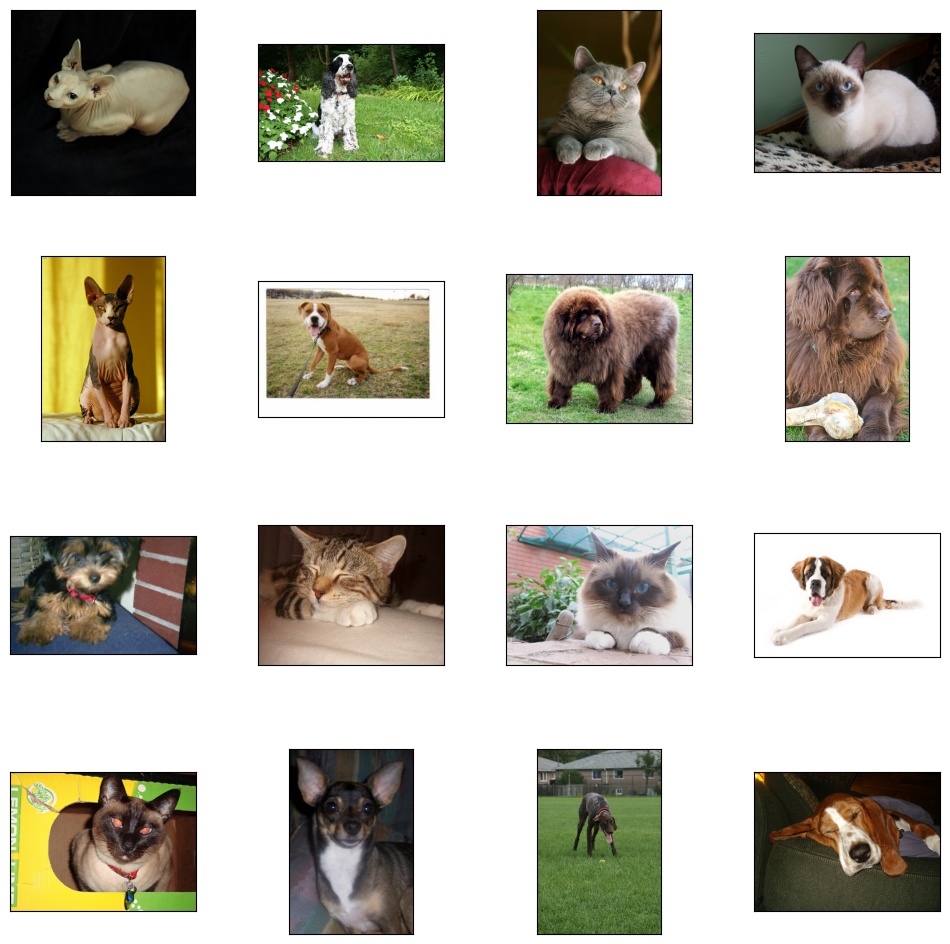

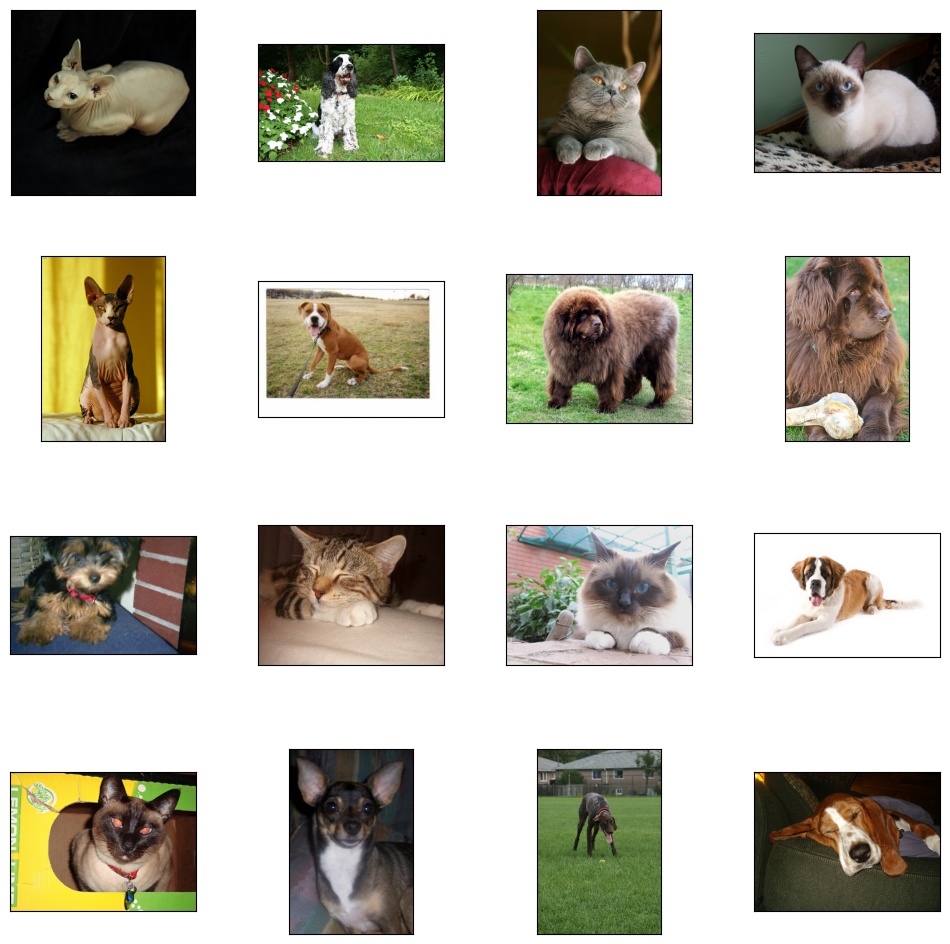

In [15]:
tfds.show_examples(dataset, info, rows=4, cols=4, image_key='image')

## tfds pipeline and label count

In [16]:
tf.keras.utils.set_random_seed(42) # sets the Python, NumPy and TensorFlow seed
tf.config.experimental.enable_op_determinism() # forces threads to work in deterministic way
dataset, info = tfds.load('oxford_iiit_pet:3.*.*', with_info=True, split='all')

# Calculate the number of examples
num_examples = info.splits['all'].num_examples # or len(dataset)
num_classes = info.features['label'].num_classes

# Shuffle the combined dataset
# dataset = dataset.shuffle(buffer_size=num_examples, seed=42)

# Calculate split sizes for 60%, 20%, 20%
train_size = int(0.6 * num_examples)
val_size = int(0.2 * num_examples)

# Create the new splits
train_dataset = dataset.take(train_size)
test_val_dataset = dataset.skip(train_size)
val_dataset = test_val_dataset.take(val_size)
test_dataset = test_val_dataset.skip(val_size)


def preprocess(ds):
    image = tf.image.resize(ds['image'], (IMAGE, IMAGE))
    image = image / 255.0
    return image,tf.one_hot( ds['label'], depth=num_classes )

IMAGE=128
BATCH_SIZE = 512

with tf.device('/GPU:0'):
  train_data = train_dataset.map(preprocess).batch(BATCH_SIZE,deterministic=True,num_parallel_calls=tf.data.AUTOTUNE).cache().prefetch(buffer_size=tf.data.AUTOTUNE)
  val_data = val_dataset.map(preprocess).batch(BATCH_SIZE,deterministic=True,num_parallel_calls=tf.data.AUTOTUNE).cache().prefetch(buffer_size=tf.data.AUTOTUNE)
  test_data = test_dataset.map(preprocess, num_parallel_calls=tf.data.AUTOTUNE).batch(BATCH_SIZE,deterministic=True,num_parallel_calls=tf.data.AUTOTUNE).cache().prefetch(buffer_size=tf.data.AUTOTUNE)

In [17]:
import numpy as np
label_counts = {}


for _, label in train_data:
    label_counts = {}
    # Convert one-hot encoded label to a scalar value
    for i in range(len(label.numpy())):
      label_scalar = np.argmax(label.numpy()[i])
      if label_scalar in label_counts:
          label_counts[label_scalar] += 1
      else:
          label_counts[label_scalar] = 1
    # Output the count of each unique label
    print("-----------------------------------------")
    for label, count in label_counts.items():
      print(f"Label {label}: {count} occurrences")
    print(len(label_counts))

-----------------------------------------
Label 33: 10 occurrences
Label 12: 18 occurrences
Label 9: 19 occurrences
Label 32: 10 occurrences
Label 2: 18 occurrences
Label 22: 17 occurrences
Label 36: 14 occurrences
Label 5: 15 occurrences
Label 6: 12 occurrences
Label 28: 14 occurrences
Label 10: 12 occurrences
Label 14: 11 occurrences
Label 3: 18 occurrences
Label 0: 9 occurrences
Label 1: 13 occurrences
Label 17: 16 occurrences
Label 25: 16 occurrences
Label 27: 14 occurrences
Label 8: 11 occurrences
Label 15: 11 occurrences
Label 29: 13 occurrences
Label 13: 17 occurrences
Label 30: 24 occurrences
Label 34: 15 occurrences
Label 16: 14 occurrences
Label 11: 15 occurrences
Label 20: 9 occurrences
Label 21: 12 occurrences
Label 19: 10 occurrences
Label 31: 14 occurrences
Label 7: 15 occurrences
Label 18: 14 occurrences
Label 26: 17 occurrences
Label 4: 11 occurrences
Label 23: 12 occurrences
Label 24: 11 occurrences
Label 35: 11 occurrences
37
-----------------------------------------


## Filters map explore

In [18]:
dataset, info = tfds.load('oxford_iiit_pet:3.*.*', with_info=True, split='train[:10]',as_supervised=True, download=False)

(500, 500, 3)
()
(313, 500, 3)
()
(500, 333, 3)
()


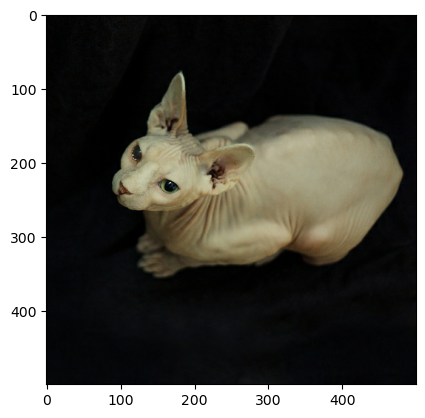

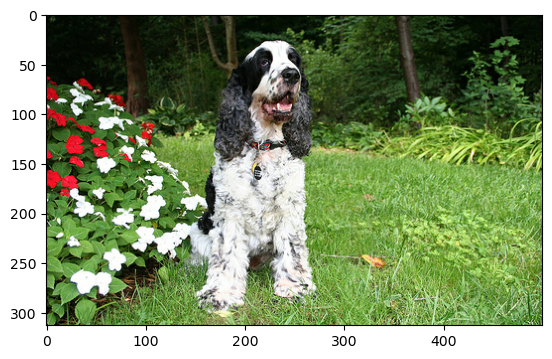

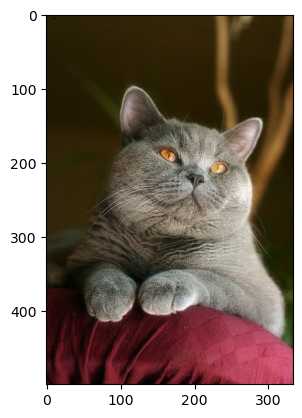

In [5]:
for image,label in dataset.take(3):
  plt.figure()
  plt.imshow(image)

### reduce brightness explore

tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(99, shape=(), dtype=uint8)


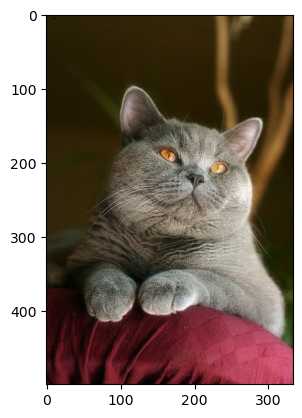

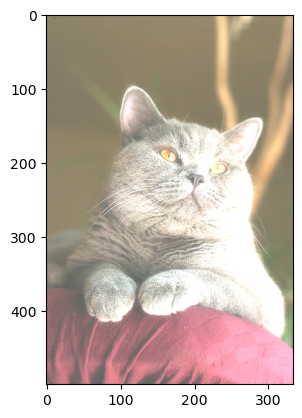

In [35]:
print(tf.reduce_max(image))
print(tf.reduce_min(image))
print("-------")
plt.figure()
plt.imshow(image)
#assumes that the image is in the range [0, 1]. If the image is in the range [0, 255], you should divide by 255 to convert it to [0, 1].
brightness_image = tf.image.adjust_brightness(image, delta=0.39)
print(tf.reduce_max(brightness_image))
print(tf.reduce_min(brightness_image))
plt.figure()
plt.imshow(brightness_image)


### random brightness explore

tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(78, shape=(), dtype=uint8)


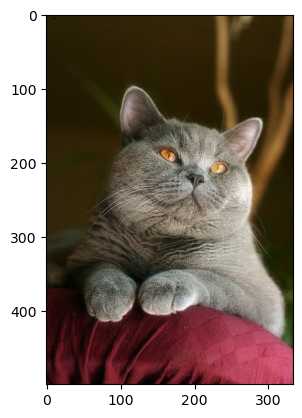

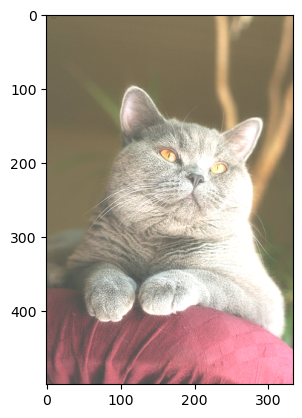

In [41]:
print(tf.reduce_max(image))
print(tf.reduce_min(image))
print("-------")
plt.figure()
plt.imshow(image)
#assumes that the image is in the range [0, 1]. If the image is in the range [0, 255], you should divide by 255 to convert it to [0, 1].
brightness_image = tf.image.random_brightness(image, max_delta=0.39)
print(tf.reduce_max(brightness_image))
print(tf.reduce_min(brightness_image))
plt.figure()
plt.imshow(brightness_image)

### random brightness map explore

In [21]:
dataset1 = dataset.map(lambda x,y: (tf.image.random_brightness(x, 0.3,42),y),num_parallel_calls=tf.data.AUTOTUNE)

tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(69, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(60, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(32, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(206, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(188, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(47, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(),

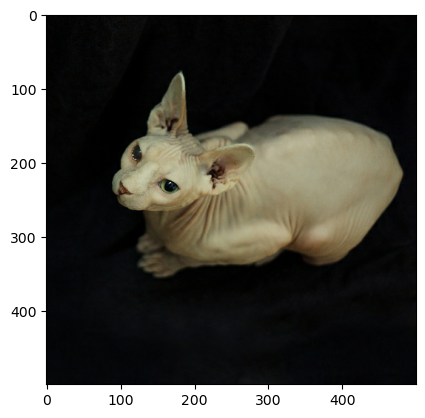

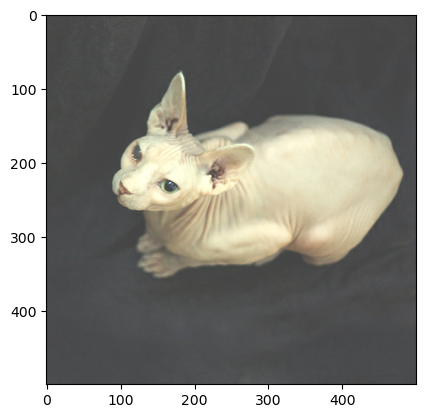

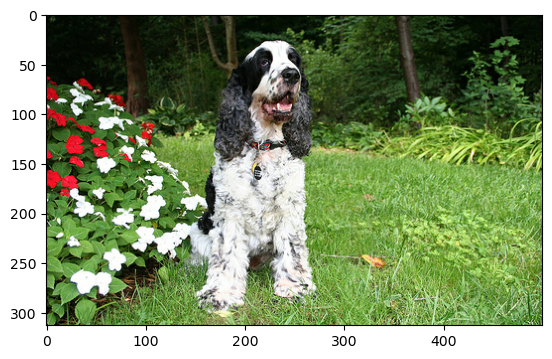

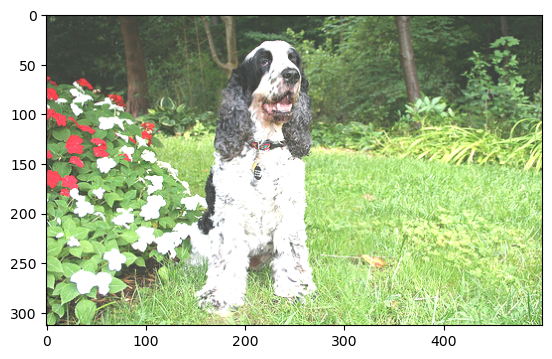

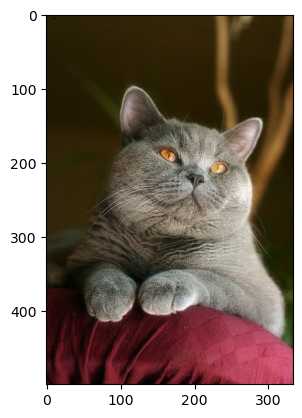

...

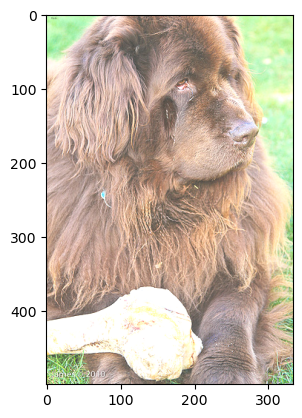

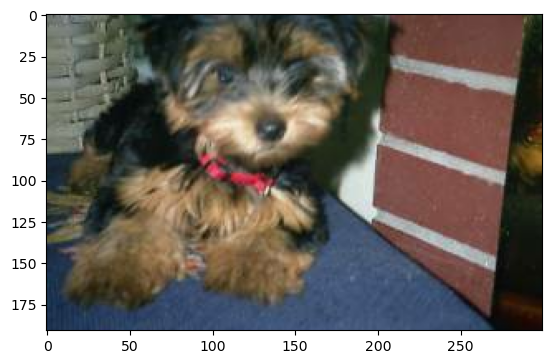

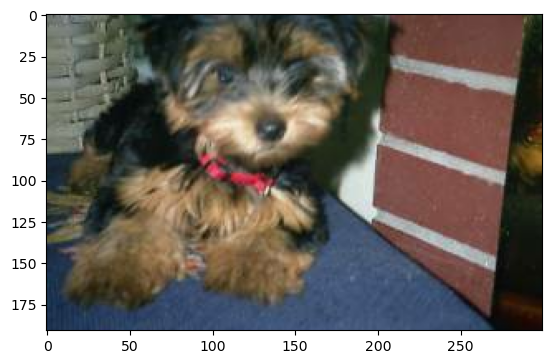

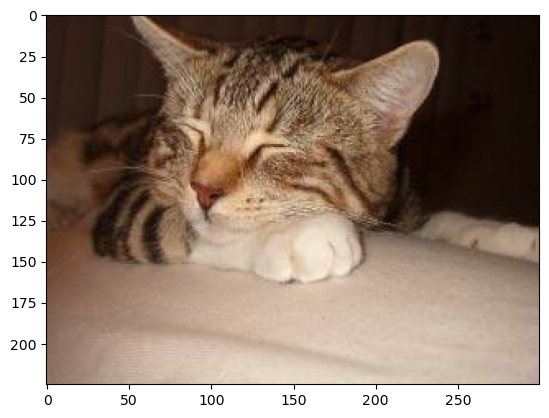

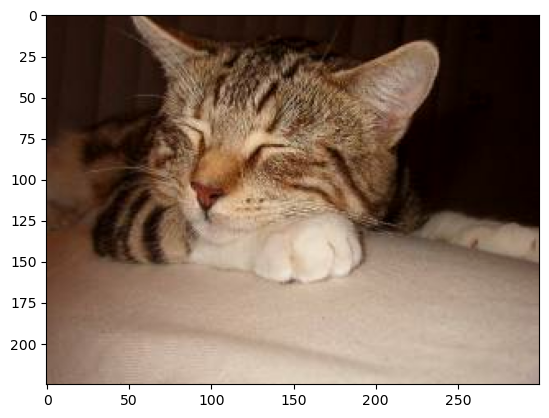

In [22]:
dataset_generator = iter(dataset1)
for image,label in dataset.take(10):
  print(tf.reduce_max(image))
  print(tf.reduce_min(image))
  print("-------")
  bri, _ = next(dataset_generator)
  print(tf.reduce_max(bri))
  print(tf.reduce_min(bri))
  print("==========")

  plt.figure()
  plt.imshow(image)
  plt.figure()
  plt.imshow(bri)

### random saturation image

#### adjust saturation

tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)


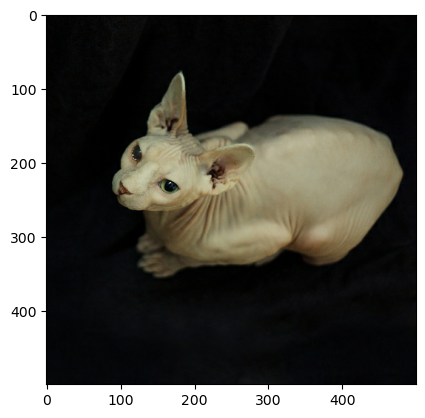

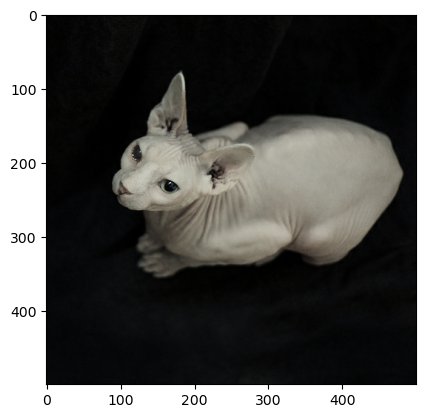

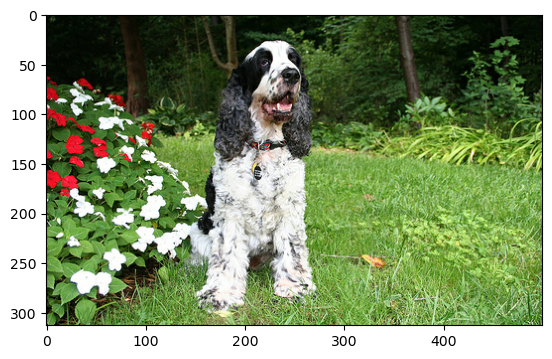

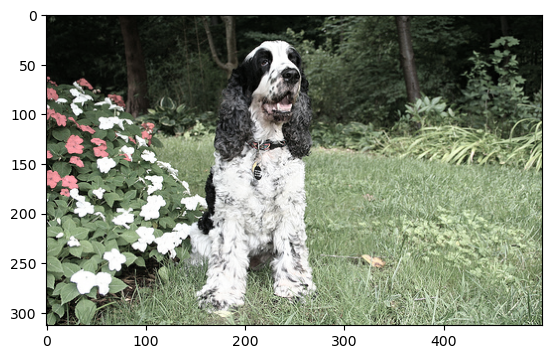

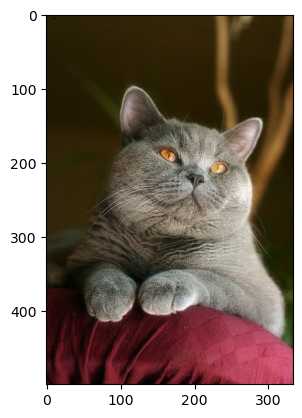

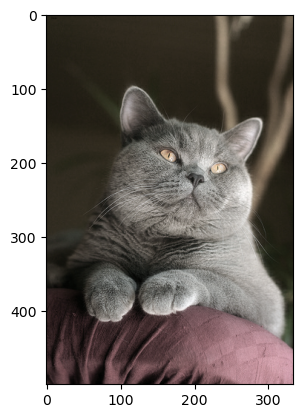

In [114]:
for image,label in dataset.take(3):
  print(tf.reduce_max(image))
  print(tf.reduce_min(image))
  print("-------")
  sat = tf.image.adjust_saturation(image, 0.4)
  print(tf.reduce_max(sat))
  print(tf.reduce_min(sat))
  print("==========")

  plt.figure()
  plt.imshow(image)
  plt.figure()
  plt.imshow(sat)

#### random saturation

In [115]:
dataset2 = dataset.map(lambda x,y: (tf.image.random_saturation(x, 0.4,2,42),y),num_parallel_calls=tf.data.AUTOTUNE)

tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dty

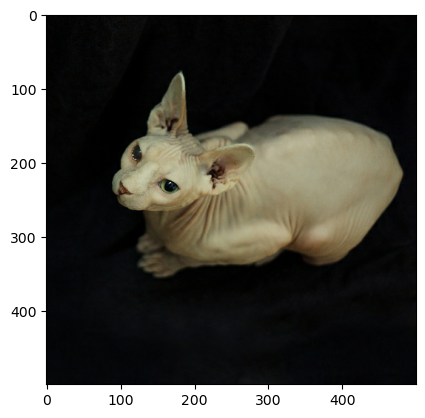

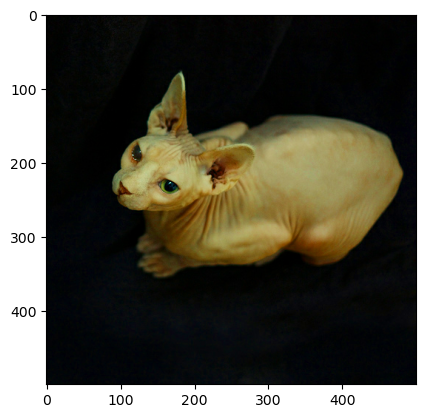

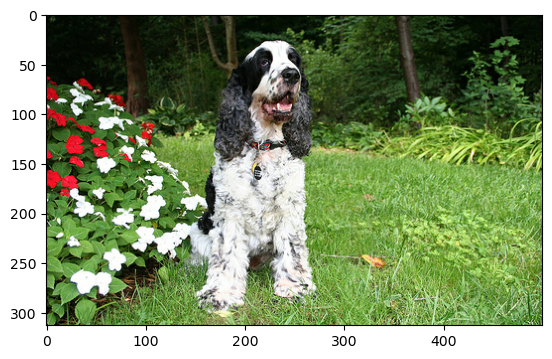

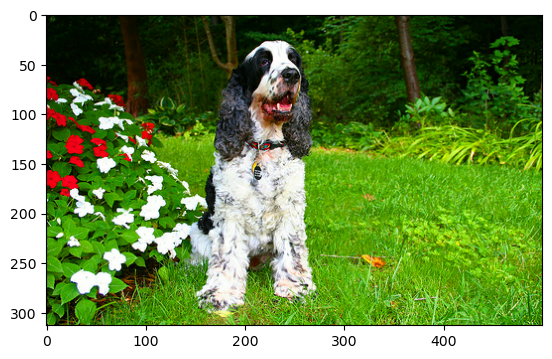

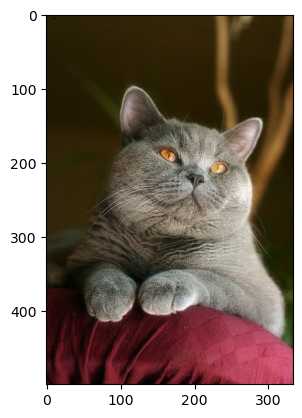

...

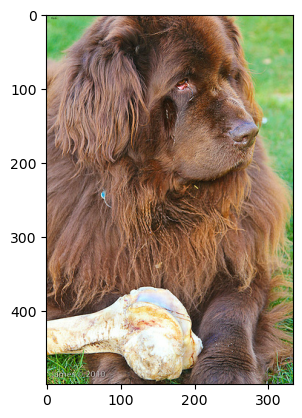

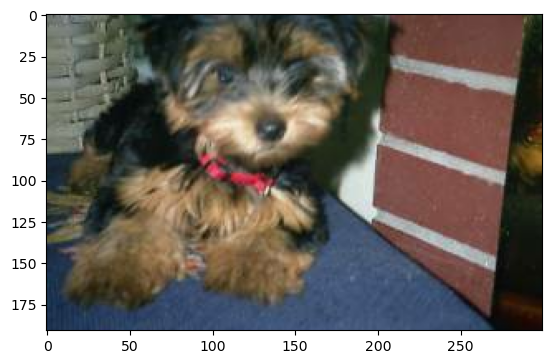

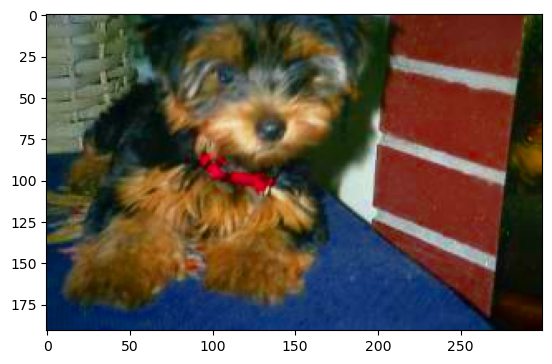

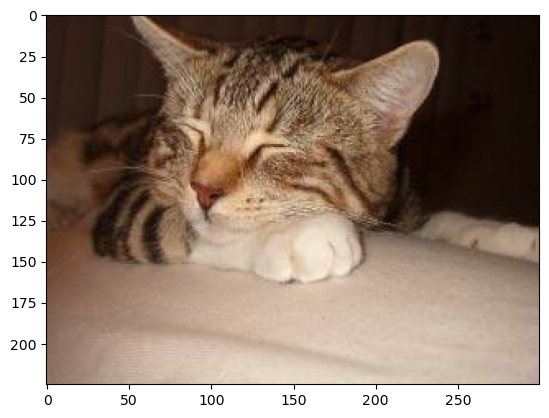

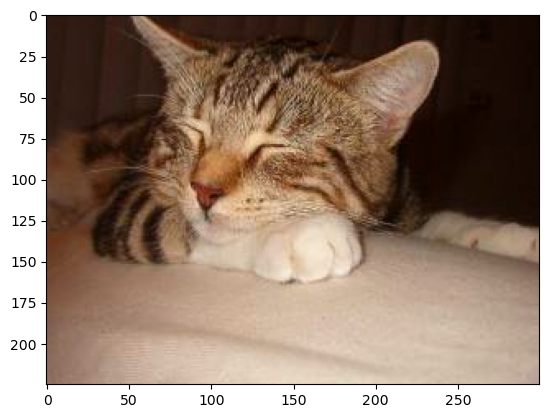

In [121]:
dataset_generator = iter(dataset2)
for image,label in dataset.take(10):
  print(tf.reduce_max(image))
  print(tf.reduce_min(image))
  print("-------")
  sat, _ = next(dataset_generator)
  print(tf.reduce_max(sat))
  print(tf.reduce_min(sat))
  print("==========")

  plt.figure()
  plt.imshow(image)
  plt.figure()
  plt.imshow(sat)

### synthetic image brightness test

(2, 2, 3)
tf.Tensor(
[[[128 129 130]
  [131 252 133]]

 [[134 135 136]
  [137 138 139]]], shape=(2, 2, 3), dtype=uint8)


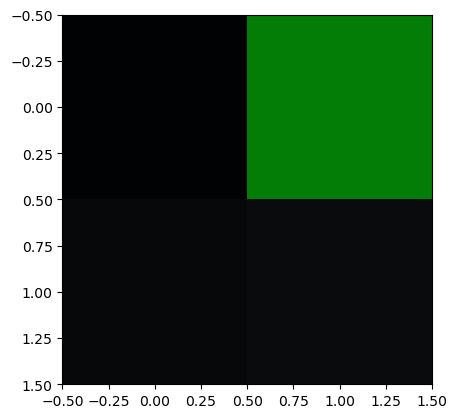

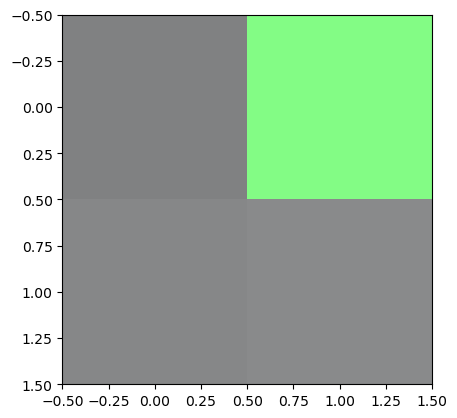

In [87]:
x=tf.constant([ [[1, 2, 3],[4, 125, 6]], [[7, 8, 9],[10, 11, 12]] ], dtype=tf.int32)
x=tf.cast(x, dtype=tf.uint8)
print(x.shape)
# print(x)
plt.figure()
plt.imshow(x)
y=tf.image.adjust_brightness(x, 0.5)
print(y)
plt.figure()
plt.imshow(y)

### synthetic image contrast test

(2, 2, 3)
tf.Tensor(
[[[ 3 19  5]
  [ 4 80  6]]

 [[ 6 22  8]
  [ 7 23  9]]], shape=(2, 2, 3), dtype=uint8)


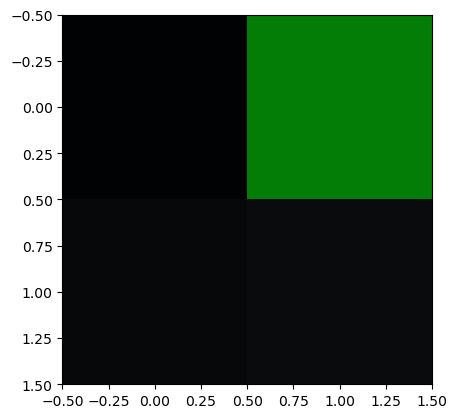

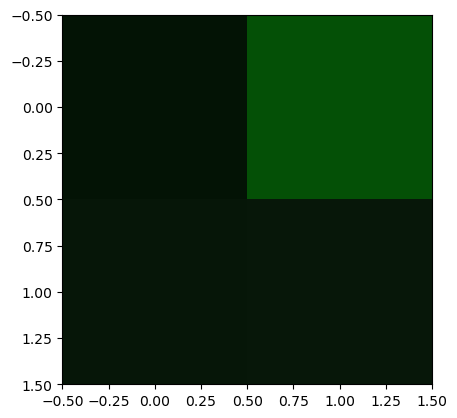

In [88]:
x=tf.constant([ [[1, 2, 3],[4, 125, 6]], [[7, 8, 9],[10, 11, 12]] ], dtype=tf.int32)
x=tf.cast(x, dtype=tf.uint8)
print(x.shape)
# print(x)
plt.figure()
plt.imshow(x)
y=tf.image.adjust_contrast(x, 0.5)
print(y)
plt.figure()
plt.imshow(y)

In [94]:
mean_x = tf.reduce_mean(tf.cast(x,tf.float32), axis=[0,1],keepdims=True)

In [97]:
mean_x

<tf.Tensor: shape=(1, 1, 3), dtype=float32, numpy=array([[[ 5.5, 36.5,  7.5]]], dtype=float32)>

In [95]:
contrast_factor = 0.5
y_float = (tf.cast(x,tf.float32) - mean_x) * contrast_factor + mean_x

In [96]:
y_float

<tf.Tensor: shape=(2, 2, 3), dtype=float32, numpy=
array([[[ 3.25, 19.25,  5.25],
        [ 4.75, 80.75,  6.75]],

       [[ 6.25, 22.25,  8.25],
        [ 7.75, 23.75,  9.75]]], dtype=float32)>

(2, 2, 3)
tf.Tensor(
[[[  0   0   0]
  [  2 213   4]]

 [[  8   0  10]
  [ 14   0  16]]], shape=(2, 2, 3), dtype=uint8)


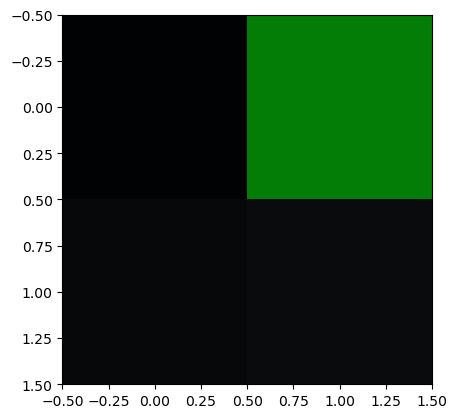

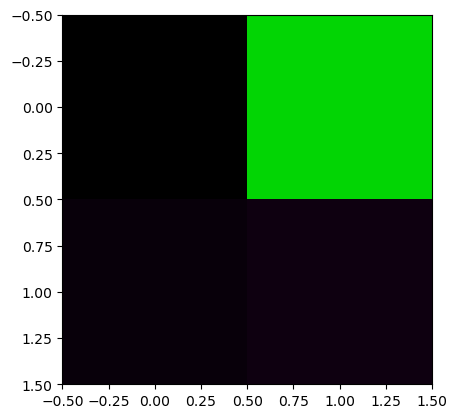

In [100]:
x=tf.constant([ [[1, 2, 3],[4, 125, 6]], [[7, 8, 9],[10, 11, 12]] ], dtype=tf.int32)
x=tf.cast(x, dtype=tf.uint8)
print(x.shape)
# print(x)
plt.figure()
plt.imshow(x)
y=tf.image.adjust_contrast(x, 2)
print(y)
plt.figure()
plt.imshow(y)

### random contrast map test

In [3]:
dataset3 = dataset.map(lambda x,y: (tf.image.random_contrast(x, 0.5,1.5,42),y),num_parallel_calls=tf.data.AUTOTUNE)

tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(186, shape=(), dtype=uint8)
tf.Tensor(39, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(228, shape=(), dtype=uint8)
tf.Tensor(18, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), d

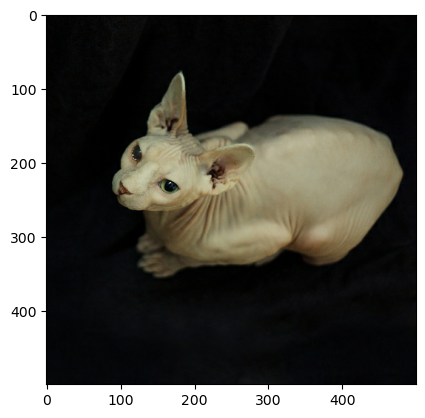

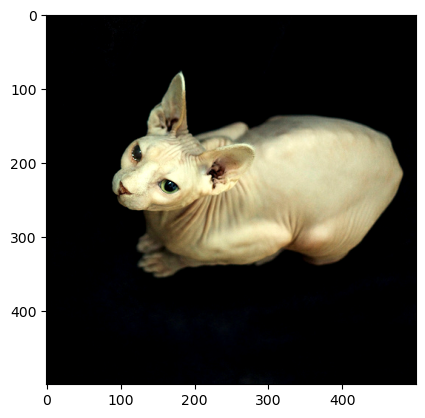

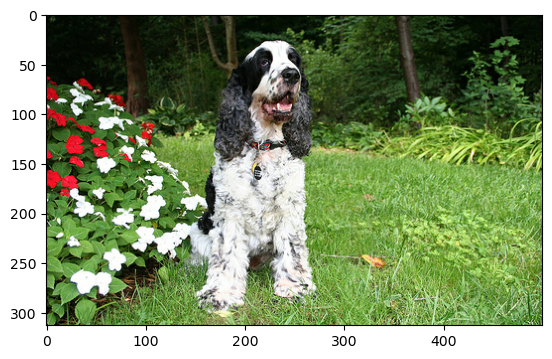

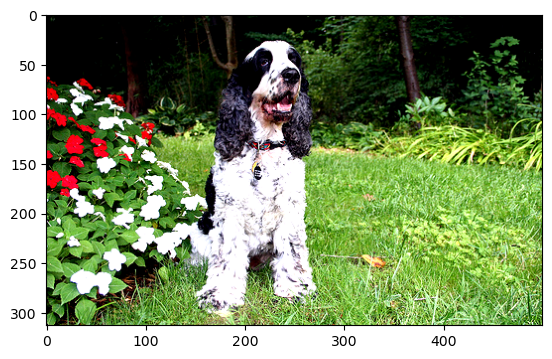

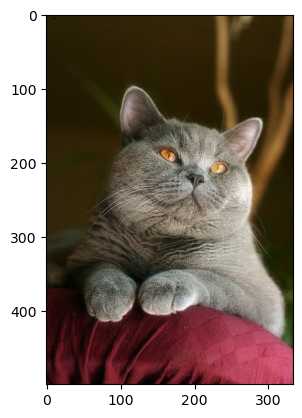

...

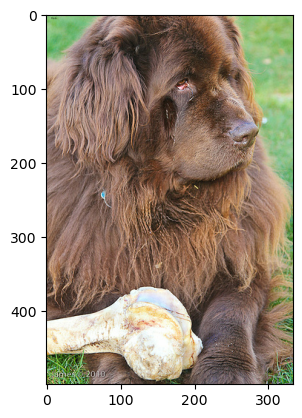

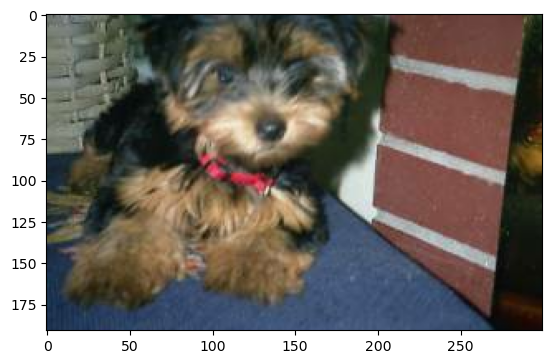

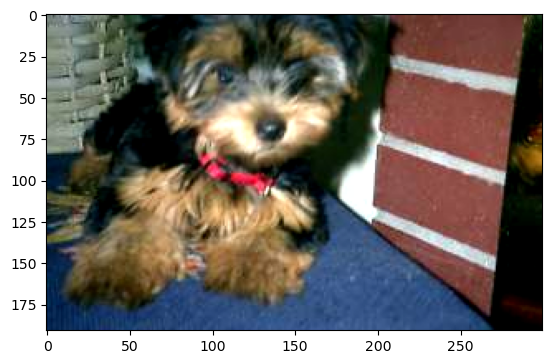

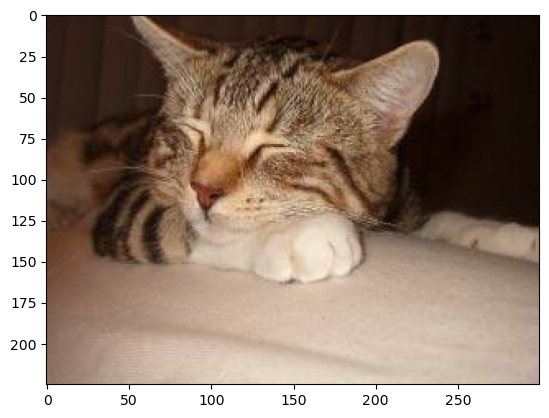

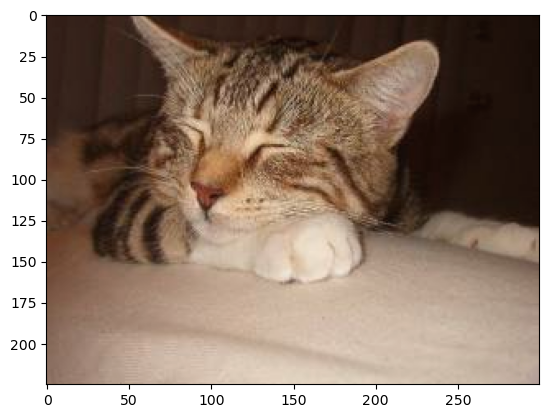

In [4]:
dataset_generator = iter(dataset3)
for image,label in dataset.take(10):
  print(tf.reduce_max(image))
  print(tf.reduce_min(image))
  print("-------")
  con, _ = next(dataset_generator)
  print(tf.reduce_max(con))
  print(tf.reduce_min(con))
  print("==========")

  plt.figure()
  plt.imshow(image)
  plt.figure()
  plt.imshow(con)

### random hue map test

#### adjust hue visualize

In [ ]:
for image,label in dataset.take(3):
  print(tf.reduce_max(image))
  print(tf.reduce_min(image))
  print("-------")
  sat = tf.image.adjust_hue(image, 0.5)
  print(tf.reduce_max(sat))
  print(tf.reduce_min(sat))
  print("==========")

  plt.figure()
  plt.imshow(image)
  plt.figure()
  plt.imshow(sat)

#### random hue

In [19]:
dataset4 = dataset.map(lambda x,y: (tf.image.random_hue(x, 0.45,42),y),num_parallel_calls=tf.data.AUTOTUNE)

tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
-------
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dtype=uint8)
tf.Tensor(255, shape=(), dtype=uint8)
tf.Tensor(0, shape=(), dty

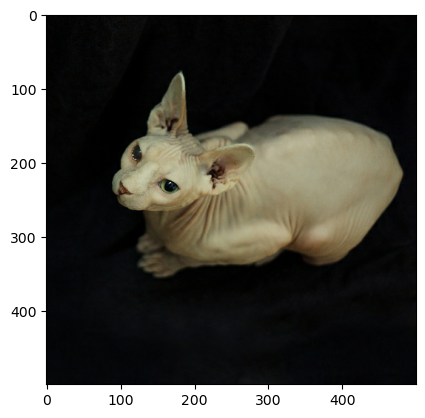

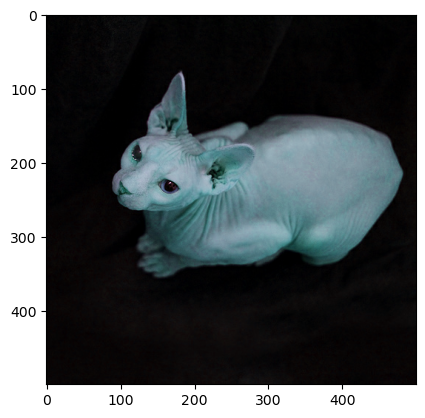

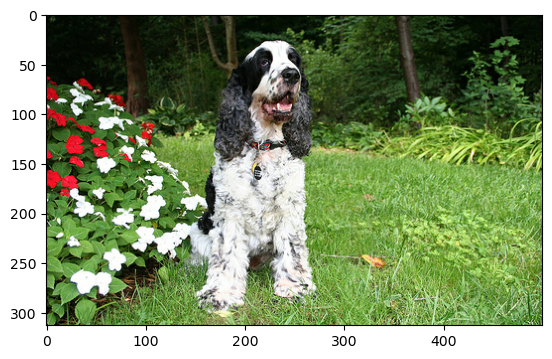

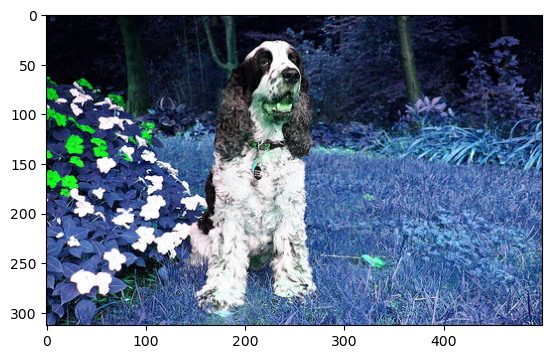

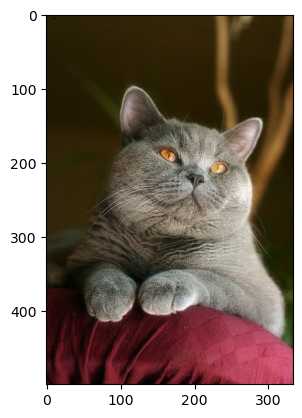

...

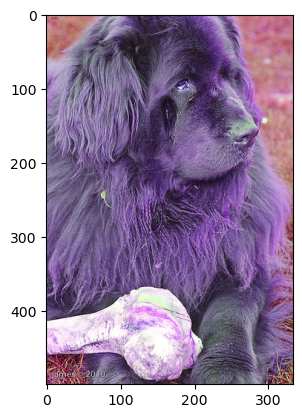

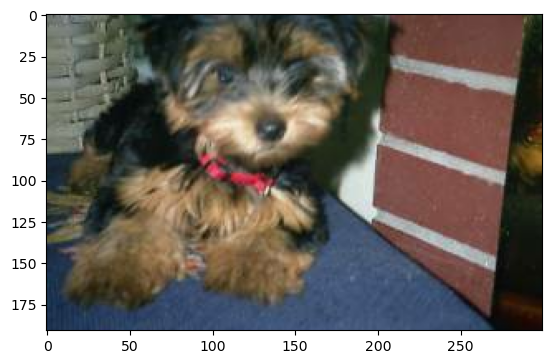

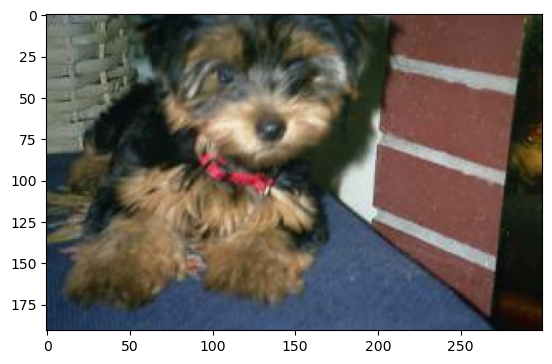

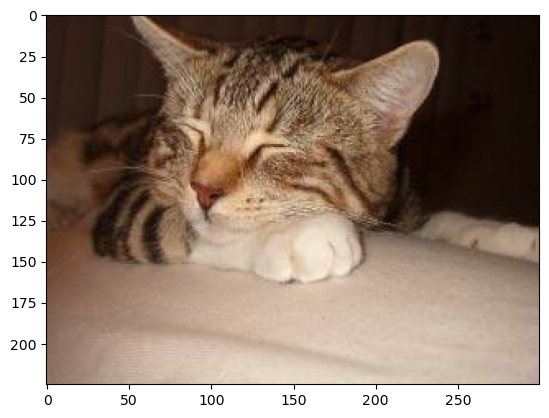

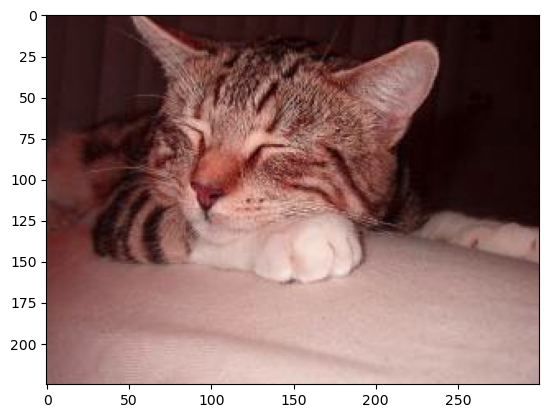

In [20]:
dataset_generator = iter(dataset4)
for image,label in dataset.take(10):
  print(tf.reduce_max(image))
  print(tf.reduce_min(image))
  print("-------")
  con, _ = next(dataset_generator)
  print(tf.reduce_max(con))
  print(tf.reduce_min(con))
  print("==========")

  plt.figure()
  plt.imshow(image)
  plt.figure()
  plt.imshow(con)